In [1]:
from IPython.display import display, HTML

display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
!python -V

Python 3.11.2


In [3]:
import binpan
from binpan import handlers

In [4]:
binpan.__version__

'0.8.3'

# Get some data

In [5]:
btcusdt = binpan.Symbol(symbol='btcusdt',
                        tick_interval='1h',
                        limit=1000,
                        time_zone='Europe/Madrid')

2023-12-01	 17:32:50     INFO get_candles_by_time_stamps -> symbol=BTCUSDT tick_interval=1h start=2023-10-21 02:32:49 end=2023-12-01 16:59:58 limit=1000
2023-12-01	 17:32:50     INFO Pruned overtime_candle_ts 1 candles from API response for BTCUSDT 1h


In [6]:
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp
BTCUSDT 1h Europe/Madrid,,,,,,,,,,,,,,
2023-10-21 03:00:00+02:00,2023-10-21 03:00:00+02:00,29628.15,29631.79,29514.19,29533.88,667.51854,2023-10-21 03:59:59.999000+02:00,1.974440e+07,31534,341.81995,1.011080e+07,0,1697850000000,1697853599999
2023-10-21 04:00:00+02:00,2023-10-21 04:00:00+02:00,29533.87,29539.35,29465.53,29486.96,752.92738,2023-10-21 04:59:59.999000+02:00,2.221216e+07,33498,381.06391,1.124244e+07,0,1697853600000,1697857199999
2023-10-21 05:00:00+02:00,2023-10-21 05:00:00+02:00,29486.96,29624.58,29464.77,29604.43,740.04199,2023-10-21 05:59:59.999000+02:00,2.186284e+07,33376,411.23923,1.214989e+07,0,1697857200000,1697860799999
2023-10-21 06:00:00+02:00,2023-10-21 06:00:00+02:00,29604.42,29627.80,29553.53,29556.13,661.39000,2023-10-21 06:59:59.999000+02:00,1.956917e+07,23862,321.40766,9.509192e+06,0,1697860800000,1697864399999
2023-10-21 07:00:00+02:00,2023-10-21 07:00:00+02:00,29556.13,29584.91,29541.86,29578.66,380.65705,2023-10-21 07:59:59.999000+02:00,1.125301e+07,20500,172.85086,5.109726e+06,0,1697864400000,1697867999999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-01 12:00:00+01:00,2023-12-01 12:00:00+01:00,38541.01,38659.40,38508.89,38580.17,1194.95019,2023-12-01 12:59:59.999000+01:00,4.611469e+07,48353,582.37526,2.247332e+07,0,1701428400000,1701431999999
2023-12-01 13:00:00+01:00,2023-12-01 13:00:00+01:00,38580.17,38629.65,38300.01,38360.95,2015.09634,2023-12-01 13:59:59.999000+01:00,7.749033e+07,73300,831.10161,3.196170e+07,0,1701432000000,1701435599999
2023-12-01 14:00:00+01:00,2023-12-01 14:00:00+01:00,38360.95,38438.81,38300.00,38367.15,1231.37160,2023-12-01 14:59:59.999000+01:00,4.724983e+07,55099,661.17135,2.537020e+07,0,1701435600000,1701439199999


# Adding some indicators

Background color is configurable

2023-12-01	 17:32:51     INFO New column: SMA_21


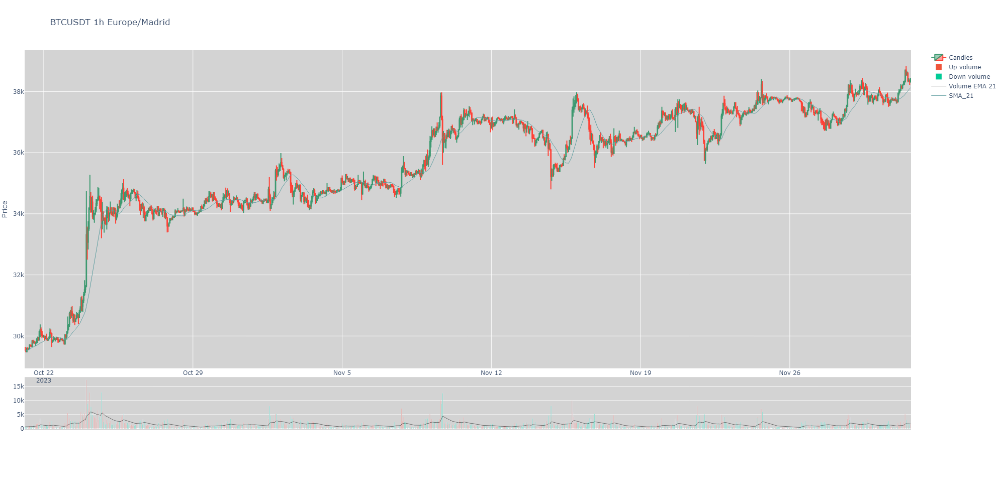

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [7]:
btcusdt.sma(21)

# background color is configurable

btcusdt.plot(background_color='lightgrey')

2023-12-01	 17:32:55     INFO New column: EMA_21


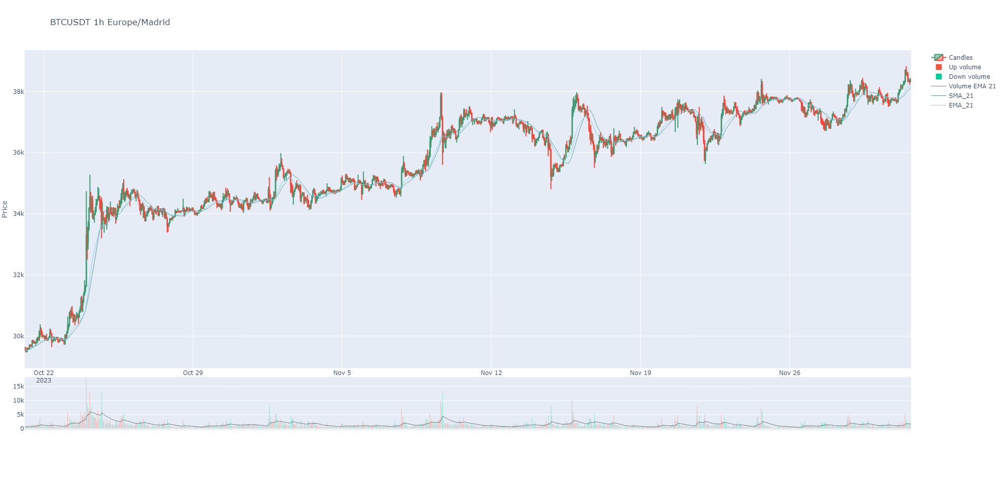

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [8]:
# add ema
btcusdt.ema(21)
btcusdt.plot()

2023-12-01	 17:32:56     INFO New column: zeros
2023-12-01	 17:32:56     INFO New column: MACD_12_26_9
2023-12-01	 17:32:56     INFO New column: MACDh_12_26_9
2023-12-01	 17:32:56     INFO New column: MACDs_12_26_9


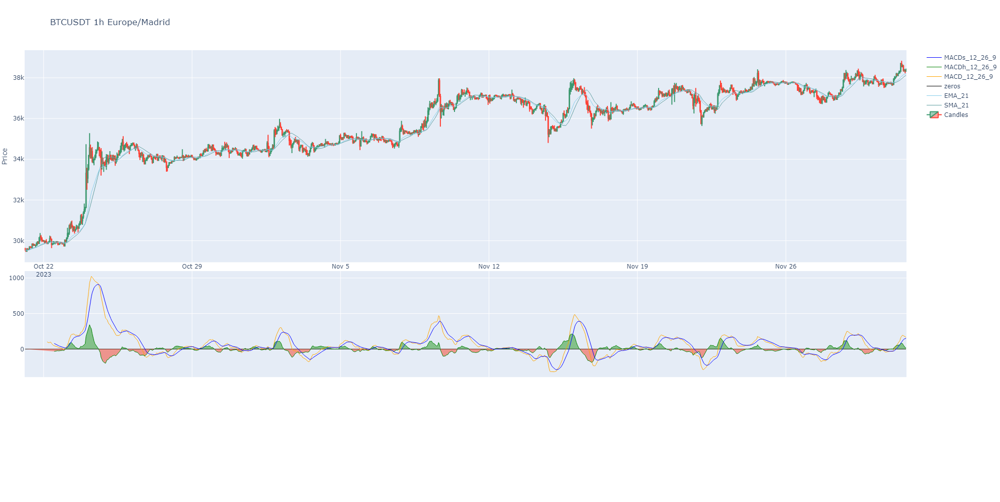

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [9]:
# now with macd
btcusdt.macd()
btcusdt.plot(candles_ta_height_ratio=0.5, volume=False)

2023-12-01	 17:32:59     INFO New column: STOCHRSIk_14_14_3_3
2023-12-01	 17:32:59     INFO New column: STOCHRSId_14_14_3_3


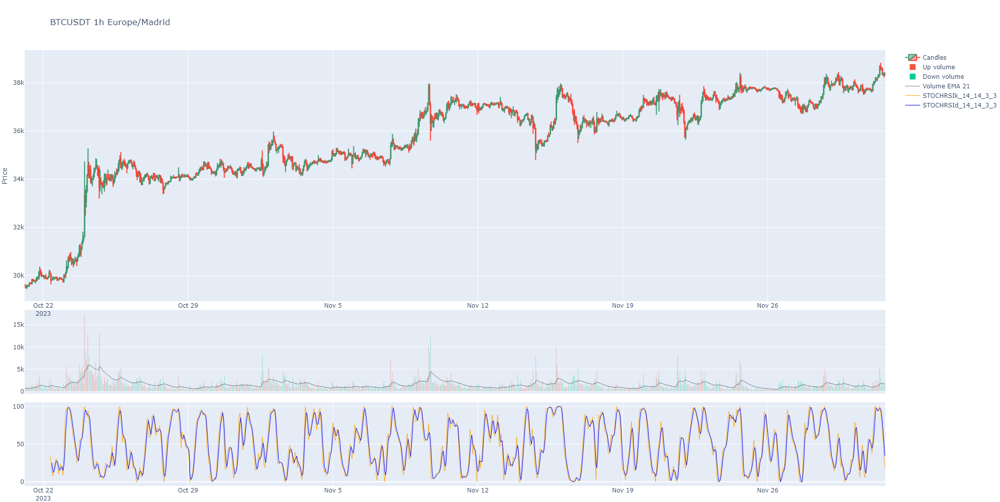

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [10]:
# it is time for stochastic rsi
btcusdt.drop(inplace=True)
btcusdt.stoch_rsi(14,3,3)
btcusdt.plot(candles_ta_height_ratio=0.6)

### Showing the colors applied 

In [11]:
btcusdt.set_plot_color()

{'STOCHRSIk_14_14_3_3': 'orange', 'STOCHRSId_14_14_3_3': 'blue'}

# Example of a generic pandas_ta indicator use:
This indicators are not added to the instance dataframe.

In [12]:
high = btcusdt.df['High']
low = btcusdt.df['Low']
close = btcusdt.df['Close']

rsi = btcusdt.pandas_ta_indicator(name = 'rsi',
                            high=high,
                            low=low, 
                            close=close,
                            length=16,
                            rsi_length=16,
                            k=3,
                            d=3)
rsi

This indicator should be plotted manually with the plotting module. Check docs for candles_ta functions and pass it as an indicator serie. Example: candles_ta(data=btcusdt.df, indicators_series=[rsi])


BTCUSDT 1h Europe/Madrid
2023-10-21 03:00:00+02:00          NaN
2023-10-21 04:00:00+02:00          NaN
2023-10-21 05:00:00+02:00          NaN
2023-10-21 06:00:00+02:00          NaN
2023-10-21 07:00:00+02:00          NaN
                               ...    
2023-12-01 12:00:00+01:00    69.119631
2023-12-01 13:00:00+01:00    59.850461
2023-12-01 14:00:00+01:00    60.012235
2023-12-01 15:00:00+01:00    58.291653
2023-12-01 16:00:00+01:00    60.795690
Name: RSI_16, Length: 999, dtype: float64

# No automated plot, because generic pandas_ta calls are not added to instances.

But can be plotted manually, example.

2023-12-01	 17:33:01     INFO Indicators random colors:  indicators_colors=['lightcoral']
2023-12-01	 17:33:01     INFO Inferred positions, sent all to bottom subplot: rows_pos=[2]


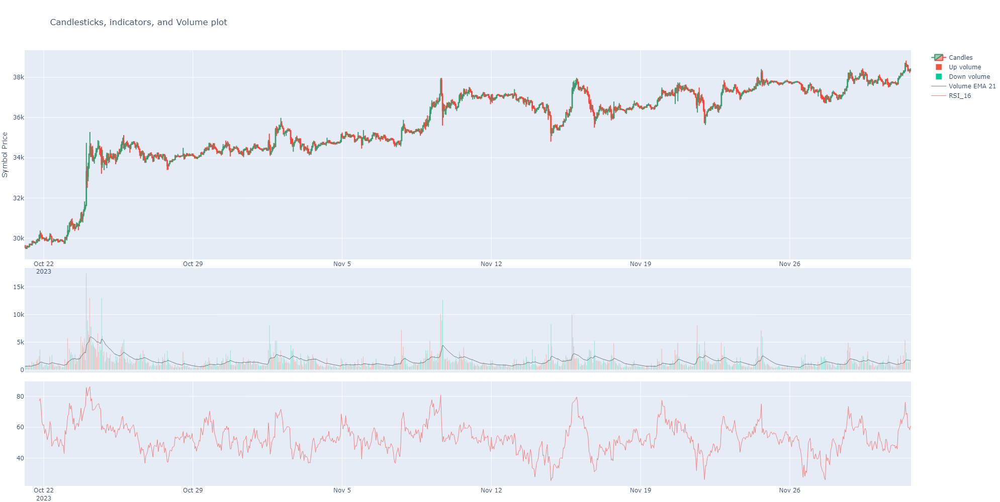

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [13]:
handlers.plotting.candles_ta(data=btcusdt.df, indicators_series=rsi)

In [14]:
# manual indicators are not added automatically to btcusdt.df
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp,STOCHRSIk_14_14_3_3,STOCHRSId_14_14_3_3
BTCUSDT 1h Europe/Madrid,,,,,,,,,,,,,,,,
2023-10-21 03:00:00+02:00,2023-10-21 03:00:00+02:00,29628.15,29631.79,29514.19,29533.88,667.51854,2023-10-21 03:59:59.999000+02:00,1.974440e+07,31534,341.81995,1.011080e+07,0,1697850000000,1697853599999,NaN,NaN
2023-10-21 04:00:00+02:00,2023-10-21 04:00:00+02:00,29533.87,29539.35,29465.53,29486.96,752.92738,2023-10-21 04:59:59.999000+02:00,2.221216e+07,33498,381.06391,1.124244e+07,0,1697853600000,1697857199999,NaN,NaN
2023-10-21 05:00:00+02:00,2023-10-21 05:00:00+02:00,29486.96,29624.58,29464.77,29604.43,740.04199,2023-10-21 05:59:59.999000+02:00,2.186284e+07,33376,411.23923,1.214989e+07,0,1697857200000,1697860799999,NaN,NaN
2023-10-21 06:00:00+02:00,2023-10-21 06:00:00+02:00,29604.42,29627.80,29553.53,29556.13,661.39000,2023-10-21 06:59:59.999000+02:00,1.956917e+07,23862,321.40766,9.509192e+06,0,1697860800000,1697864399999,NaN,NaN
2023-10-21 07:00:00+02:00,2023-10-21 07:00:00+02:00,29556.13,29584.91,29541.86,29578.66,380.65705,2023-10-21 07:59:59.999000+02:00,1.125301e+07,20500,172.85086,5.109726e+06,0,1697864400000,1697867999999,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-01 12:00:00+01:00,2023-12-01 12:00:00+01:00,38541.01,38659.40,38508.89,38580.17,1194.95019,2023-12-01 12:59:59.999000+01:00,4.611469e+07,48353,582.37526,2.247332e+07,0,1701428400000,1701431999999,82.629826,91.169136
2023-12-01 13:00:00+01:00,2023-12-01 13:00:00+01:00,38580.17,38629.65,38300.01,38360.95,2015.09634,2023-12-01 13:59:59.999000+01:00,7.749033e+07,73300,831.10161,3.196170e+07,0,1701432000000,1701435599999,63.954194,79.153867
2023-12-01 14:00:00+01:00,2023-12-01 14:00:00+01:00,38360.95,38438.81,38300.00,38367.15,1231.37160,2023-12-01 14:59:59.999000+01:00,4.724983e+07,55099,661.17135,2.537020e+07,0,1701435600000,1701439199999,54.580298,67.054773


# Cleaning data
Before plotting more indicators, let's drop some indicators.

In [15]:
btcusdt.row_control

{'STOCHRSIk_14_14_3_3': 2, 'STOCHRSId_14_14_3_3': 2}

In [16]:
btcusdt.df.columns

Index(['Open time', 'Open', 'High', 'Low', 'Close', 'Volume', 'Close time', 'Quote volume', 'Trades', 'Taker buy base volume', 'Taker buy quote volume', 'Ignore', 'Open timestamp', 'Close timestamp', 'STOCHRSIk_14_14_3_3', 'STOCHRSId_14_14_3_3'], dtype='object')

In [17]:
btcusdt.drop(columns_to_drop=['STOCHRSIk_14_14_3_3', 'STOCHRSId_14_14_3_3'], inplace=True)
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp
BTCUSDT 1h Europe/Madrid,,,,,,,,,,,,,,
2023-10-21 03:00:00+02:00,2023-10-21 03:00:00+02:00,29628.15,29631.79,29514.19,29533.88,667.51854,2023-10-21 03:59:59.999000+02:00,1.974440e+07,31534,341.81995,1.011080e+07,0,1697850000000,1697853599999
2023-10-21 04:00:00+02:00,2023-10-21 04:00:00+02:00,29533.87,29539.35,29465.53,29486.96,752.92738,2023-10-21 04:59:59.999000+02:00,2.221216e+07,33498,381.06391,1.124244e+07,0,1697853600000,1697857199999
2023-10-21 05:00:00+02:00,2023-10-21 05:00:00+02:00,29486.96,29624.58,29464.77,29604.43,740.04199,2023-10-21 05:59:59.999000+02:00,2.186284e+07,33376,411.23923,1.214989e+07,0,1697857200000,1697860799999
2023-10-21 06:00:00+02:00,2023-10-21 06:00:00+02:00,29604.42,29627.80,29553.53,29556.13,661.39000,2023-10-21 06:59:59.999000+02:00,1.956917e+07,23862,321.40766,9.509192e+06,0,1697860800000,1697864399999
2023-10-21 07:00:00+02:00,2023-10-21 07:00:00+02:00,29556.13,29584.91,29541.86,29578.66,380.65705,2023-10-21 07:59:59.999000+02:00,1.125301e+07,20500,172.85086,5.109726e+06,0,1697864400000,1697867999999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-01 12:00:00+01:00,2023-12-01 12:00:00+01:00,38541.01,38659.40,38508.89,38580.17,1194.95019,2023-12-01 12:59:59.999000+01:00,4.611469e+07,48353,582.37526,2.247332e+07,0,1701428400000,1701431999999
2023-12-01 13:00:00+01:00,2023-12-01 13:00:00+01:00,38580.17,38629.65,38300.01,38360.95,2015.09634,2023-12-01 13:59:59.999000+01:00,7.749033e+07,73300,831.10161,3.196170e+07,0,1701432000000,1701435599999
2023-12-01 14:00:00+01:00,2023-12-01 14:00:00+01:00,38360.95,38438.81,38300.00,38367.15,1231.37160,2023-12-01 14:59:59.999000+01:00,4.724983e+07,55099,661.17135,2.537020e+07,0,1701435600000,1701439199999


# Not dropped indicators are kept on plot control

In [18]:
# maybe not this time, cause no indicator
btcusdt.row_control

{}

# Continuing with more indicators

2023-12-01	 17:33:02     INFO New column: SUPERT_10_3.0
2023-12-01	 17:33:02     INFO New column: SUPERTd_10_3.0
2023-12-01	 17:33:02     INFO New column: SUPERTl_10_3.0
2023-12-01	 17:33:02     INFO New column: SUPERTs_10_3.0


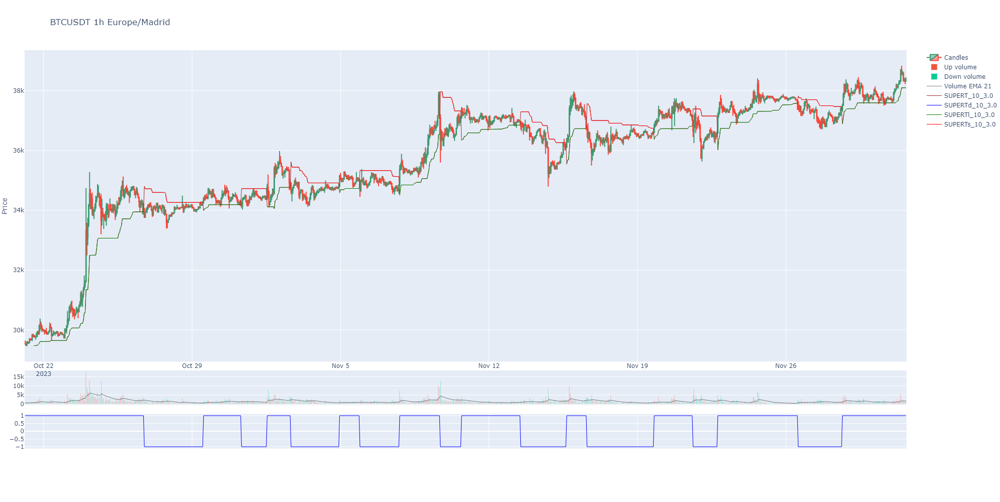

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [19]:
btcusdt.supertrend(length=10, multiplier=3)
btcusdt.plot()

In [20]:
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp,SUPERT_10_3.0,SUPERTd_10_3.0,SUPERTl_10_3.0,SUPERTs_10_3.0
BTCUSDT 1h Europe/Madrid,,,,,,,,,,,,,,,,,,
2023-10-21 03:00:00+02:00,2023-10-21 03:00:00+02:00,29628.15,29631.79,29514.19,29533.88,667.51854,2023-10-21 03:59:59.999000+02:00,1.974440e+07,31534,341.81995,1.011080e+07,0,1697850000000,1697853599999,NaN,1,NaN,NaN
2023-10-21 04:00:00+02:00,2023-10-21 04:00:00+02:00,29533.87,29539.35,29465.53,29486.96,752.92738,2023-10-21 04:59:59.999000+02:00,2.221216e+07,33498,381.06391,1.124244e+07,0,1697853600000,1697857199999,NaN,1,NaN,NaN
2023-10-21 05:00:00+02:00,2023-10-21 05:00:00+02:00,29486.96,29624.58,29464.77,29604.43,740.04199,2023-10-21 05:59:59.999000+02:00,2.186284e+07,33376,411.23923,1.214989e+07,0,1697857200000,1697860799999,NaN,1,NaN,NaN
2023-10-21 06:00:00+02:00,2023-10-21 06:00:00+02:00,29604.42,29627.80,29553.53,29556.13,661.39000,2023-10-21 06:59:59.999000+02:00,1.956917e+07,23862,321.40766,9.509192e+06,0,1697860800000,1697864399999,NaN,1,NaN,NaN
2023-10-21 07:00:00+02:00,2023-10-21 07:00:00+02:00,29556.13,29584.91,29541.86,29578.66,380.65705,2023-10-21 07:59:59.999000+02:00,1.125301e+07,20500,172.85086,5.109726e+06,0,1697864400000,1697867999999,NaN,1,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-01 12:00:00+01:00,2023-12-01 12:00:00+01:00,38541.01,38659.40,38508.89,38580.17,1194.95019,2023-12-01 12:59:59.999000+01:00,4.611469e+07,48353,582.37526,2.247332e+07,0,1701428400000,1701431999999,38098.50736,1,38098.50736,NaN
2023-12-01 13:00:00+01:00,2023-12-01 13:00:00+01:00,38580.17,38629.65,38300.01,38360.95,2015.09634,2023-12-01 13:59:59.999000+01:00,7.749033e+07,73300,831.10161,3.196170e+07,0,1701432000000,1701435599999,38098.50736,1,38098.50736,NaN
2023-12-01 14:00:00+01:00,2023-12-01 14:00:00+01:00,38360.95,38438.81,38300.00,38367.15,1231.37160,2023-12-01 14:59:59.999000+01:00,4.724983e+07,55099,661.17135,2.537020e+07,0,1701435600000,1701439199999,38098.50736,1,38098.50736,NaN


2023-12-01	 17:33:04     INFO New column: OBV


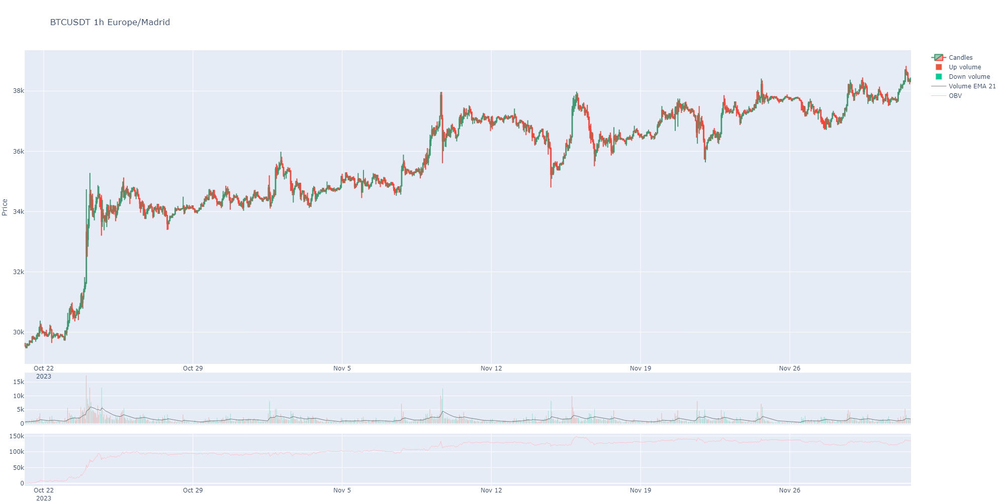

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [21]:
btcusdt.drop(inplace=True)
btcusdt.on_balance_volume()
btcusdt.plot()

In [22]:
btcusdt.row_counter

2

In [23]:
btcusdt.row_control

{'OBV': 2}

2023-12-01	 17:33:05     INFO New column: RSI_14


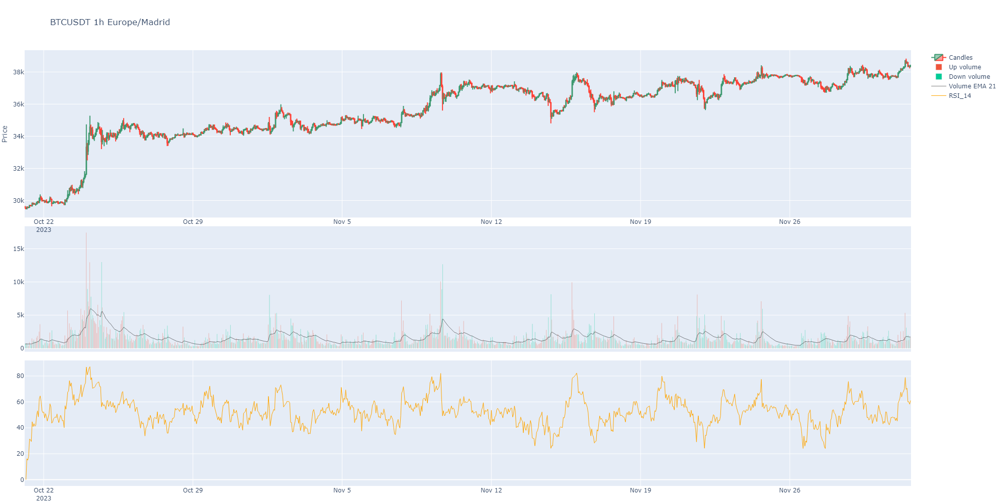

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [24]:
btcusdt.drop(inplace=True)
btcusdt.rsi(length=14)
btcusdt.plot(candles_ta_height_ratio=0.4)

### Repeating request for an indicator don't adds it to the plot control

2023-12-01	 17:33:06     INFO Existing column: RSI_14 -> No data added to instance.


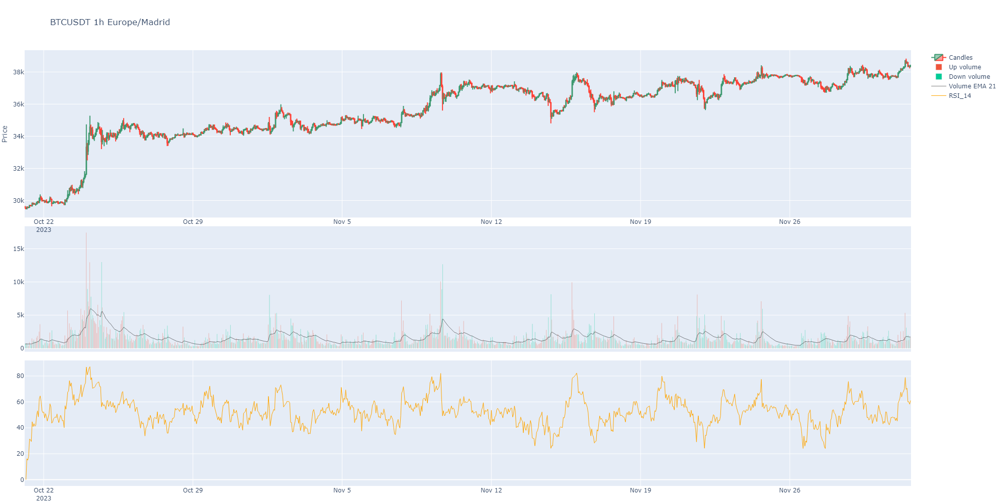

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [25]:
btcusdt.rsi(length=14)
btcusdt.plot(candles_ta_height_ratio=0.4)

In [26]:
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp,RSI_14
BTCUSDT 1h Europe/Madrid,,,,,,,,,,,,,,,
2023-10-21 03:00:00+02:00,2023-10-21 03:00:00+02:00,29628.15,29631.79,29514.19,29533.88,667.51854,2023-10-21 03:59:59.999000+02:00,1.974440e+07,31534,341.81995,1.011080e+07,0,1697850000000,1697853599999,NaN
2023-10-21 04:00:00+02:00,2023-10-21 04:00:00+02:00,29533.87,29539.35,29465.53,29486.96,752.92738,2023-10-21 04:59:59.999000+02:00,2.221216e+07,33498,381.06391,1.124244e+07,0,1697853600000,1697857199999,0.000000
2023-10-21 05:00:00+02:00,2023-10-21 05:00:00+02:00,29486.96,29624.58,29464.77,29604.43,740.04199,2023-10-21 05:59:59.999000+02:00,2.186284e+07,33376,411.23923,1.214989e+07,0,1697857200000,1697860799999,16.148633
2023-10-21 06:00:00+02:00,2023-10-21 06:00:00+02:00,29604.42,29627.80,29553.53,29556.13,661.39000,2023-10-21 06:59:59.999000+02:00,1.956917e+07,23862,321.40766,9.509192e+06,0,1697860800000,1697864399999,15.070973
2023-10-21 07:00:00+02:00,2023-10-21 07:00:00+02:00,29556.13,29584.91,29541.86,29578.66,380.65705,2023-10-21 07:59:59.999000+02:00,1.125301e+07,20500,172.85086,5.109726e+06,0,1697864400000,1697867999999,17.825714
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-01 12:00:00+01:00,2023-12-01 12:00:00+01:00,38541.01,38659.40,38508.89,38580.17,1194.95019,2023-12-01 12:59:59.999000+01:00,4.611469e+07,48353,582.37526,2.247332e+07,0,1701428400000,1701431999999,70.540496
2023-12-01 13:00:00+01:00,2023-12-01 13:00:00+01:00,38580.17,38629.65,38300.01,38360.95,2015.09634,2023-12-01 13:59:59.999000+01:00,7.749033e+07,73300,831.10161,3.196170e+07,0,1701432000000,1701435599999,59.992590
2023-12-01 14:00:00+01:00,2023-12-01 14:00:00+01:00,38360.95,38438.81,38300.00,38367.15,1231.37160,2023-12-01 14:59:59.999000+01:00,4.724983e+07,55099,661.17135,2.537020e+07,0,1701435600000,1701439199999,60.173971


In [27]:
btcusdt.row_counter

2

In [28]:
btcusdt.row_control

{'RSI_14': 2}

### Adding more indicators

2023-12-01	 17:33:08     INFO New column: AD


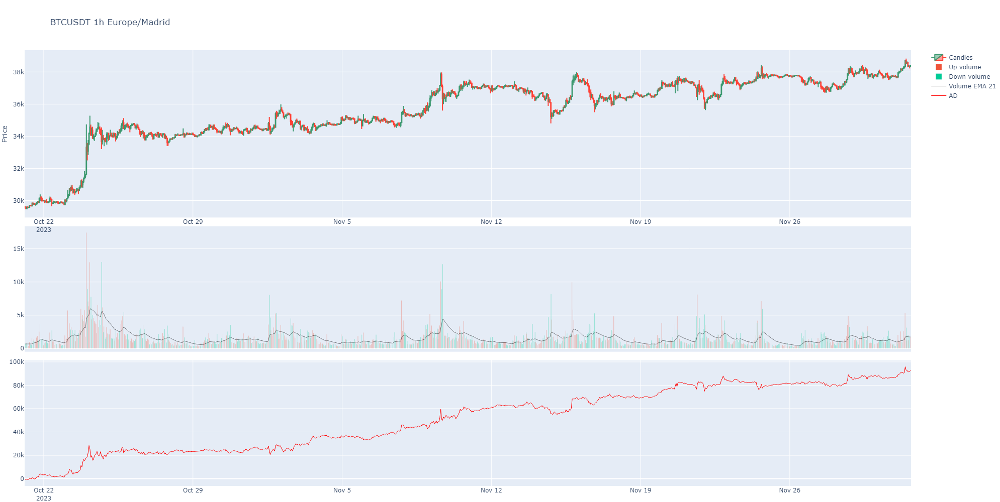

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [29]:
btcusdt.drop(inplace=True)
btcusdt.accumulation_distribution()
btcusdt.plot(candles_ta_height_ratio=0.4)

## Cleaning again

In [30]:
btcusdt.drop(inplace=True)
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp
BTCUSDT 1h Europe/Madrid,,,,,,,,,,,,,,
2023-10-21 03:00:00+02:00,2023-10-21 03:00:00+02:00,29628.15,29631.79,29514.19,29533.88,667.51854,2023-10-21 03:59:59.999000+02:00,1.974440e+07,31534,341.81995,1.011080e+07,0,1697850000000,1697853599999
2023-10-21 04:00:00+02:00,2023-10-21 04:00:00+02:00,29533.87,29539.35,29465.53,29486.96,752.92738,2023-10-21 04:59:59.999000+02:00,2.221216e+07,33498,381.06391,1.124244e+07,0,1697853600000,1697857199999
2023-10-21 05:00:00+02:00,2023-10-21 05:00:00+02:00,29486.96,29624.58,29464.77,29604.43,740.04199,2023-10-21 05:59:59.999000+02:00,2.186284e+07,33376,411.23923,1.214989e+07,0,1697857200000,1697860799999
2023-10-21 06:00:00+02:00,2023-10-21 06:00:00+02:00,29604.42,29627.80,29553.53,29556.13,661.39000,2023-10-21 06:59:59.999000+02:00,1.956917e+07,23862,321.40766,9.509192e+06,0,1697860800000,1697864399999
2023-10-21 07:00:00+02:00,2023-10-21 07:00:00+02:00,29556.13,29584.91,29541.86,29578.66,380.65705,2023-10-21 07:59:59.999000+02:00,1.125301e+07,20500,172.85086,5.109726e+06,0,1697864400000,1697867999999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-01 12:00:00+01:00,2023-12-01 12:00:00+01:00,38541.01,38659.40,38508.89,38580.17,1194.95019,2023-12-01 12:59:59.999000+01:00,4.611469e+07,48353,582.37526,2.247332e+07,0,1701428400000,1701431999999
2023-12-01 13:00:00+01:00,2023-12-01 13:00:00+01:00,38580.17,38629.65,38300.01,38360.95,2015.09634,2023-12-01 13:59:59.999000+01:00,7.749033e+07,73300,831.10161,3.196170e+07,0,1701432000000,1701435599999
2023-12-01 14:00:00+01:00,2023-12-01 14:00:00+01:00,38360.95,38438.81,38300.00,38367.15,1231.37160,2023-12-01 14:59:59.999000+01:00,4.724983e+07,55099,661.17135,2.537020e+07,0,1701435600000,1701439199999


E:\PycharmProjects\binpan_studio\binpan\symbol_manager.py:2655: UserWarning:

Converting to PeriodArray/Index representation will drop timezone information.

2023-12-01	 17:33:09     INFO New column: VWAP_D


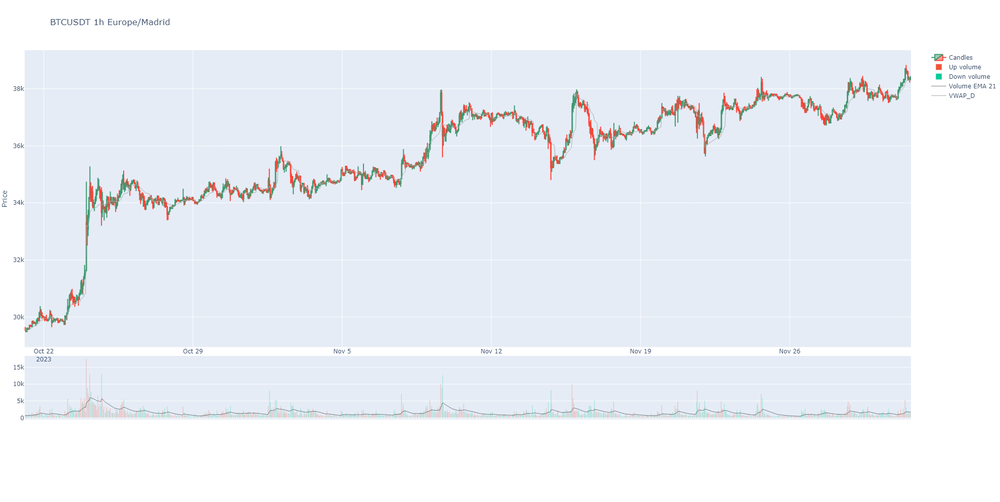

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [31]:
btcusdt.vwap()
btcusdt.plot(candles_ta_height_ratio=0.7)

# maybe, you get a pandas_ta library warning

2023-12-01	 17:33:10     INFO New column: ATRr_14


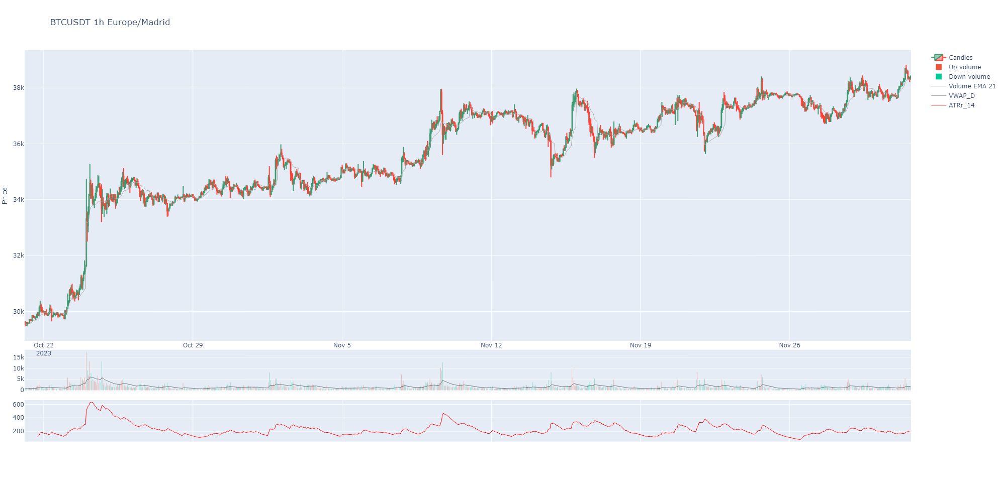

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [32]:
btcusdt.atr()
btcusdt.plot(candles_ta_height_ratio=0.7)

2023-12-01	 17:33:12     INFO New column: CCI_14_0.015


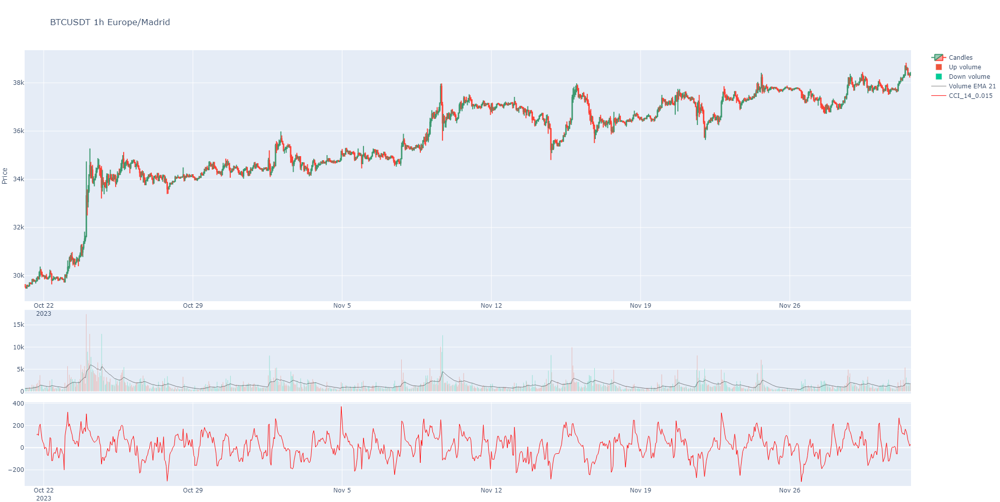

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [33]:
btcusdt.drop(inplace=True)
btcusdt.cci()
btcusdt.plot(candles_ta_height_ratio=0.6)

2023-12-01	 17:33:13     INFO New column: EOM_14_100000000


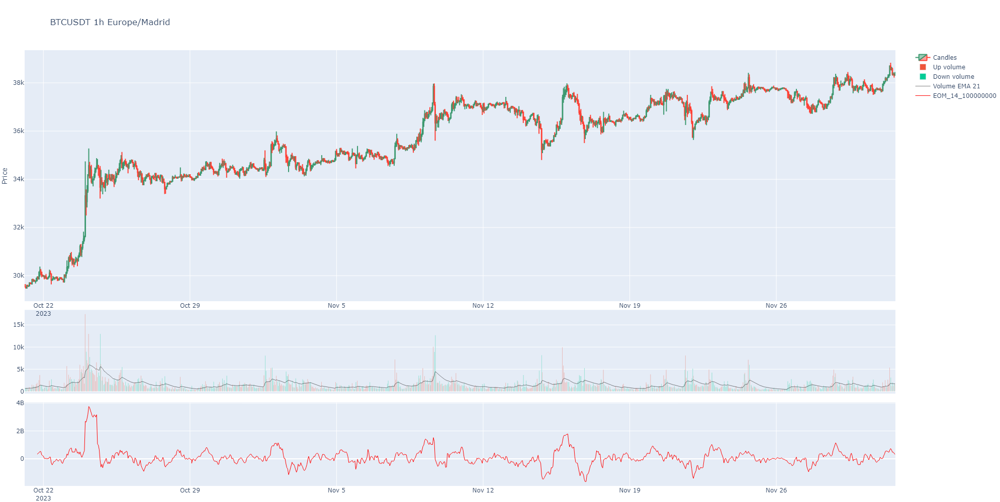

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [34]:
btcusdt.drop(inplace=True)
btcusdt.eom(length=14, divisor=100000000, drift=1)
btcusdt.plot(candles_ta_height_ratio=0.6)

2023-12-01	 17:33:14     INFO New column: ROC_1


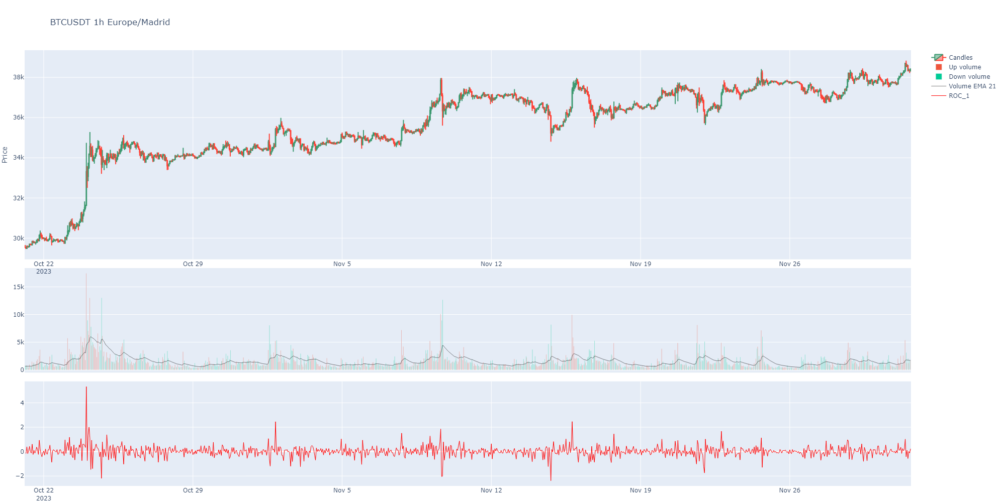

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [35]:
btcusdt.drop(inplace=True)
btcusdt.roc()
btcusdt.plot(candles_ta_height_ratio=0.5)

2023-12-01	 17:33:15     INFO New column: Ichimoku_tenkan_9
2023-12-01	 17:33:15     INFO New column: Ichimoku_kijun_26
2023-12-01	 17:33:15     INFO New column: Ichimoku_chikou_span26
2023-12-01	 17:33:15     INFO New column: Ichimoku_cloud_9_26
2023-12-01	 17:33:15     INFO New column: Ichimoku_cloud_52


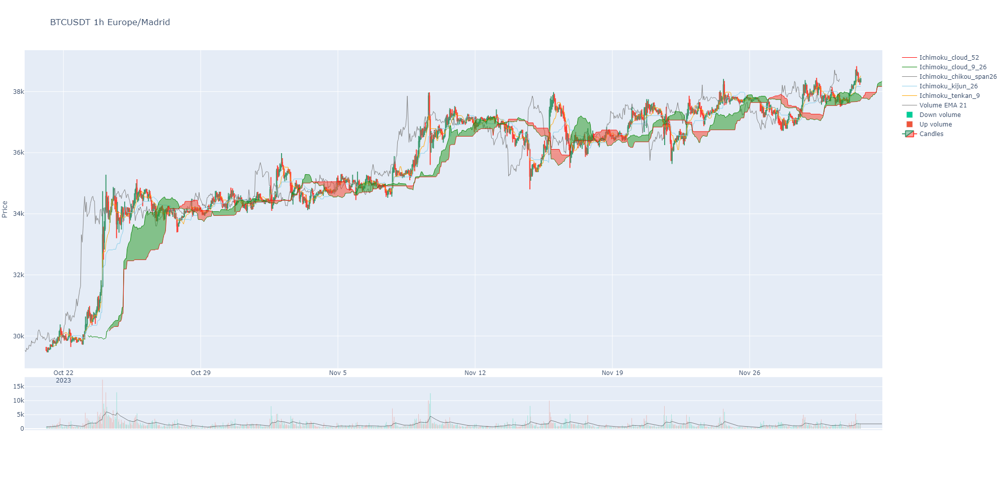

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [36]:
btcusdt.drop(inplace=True)
btcusdt.ichimoku()
btcusdt.plot()

2023-12-01	 17:33:18     INFO New column: BBL_5_2.0_
2023-12-01	 17:33:18     INFO New column: BBM_5_2.0_
2023-12-01	 17:33:18     INFO New column: BBU_5_2.0_
2023-12-01	 17:33:18     INFO New column: BBB_5_2.0_
2023-12-01	 17:33:18     INFO New column: BBP_5_2.0_


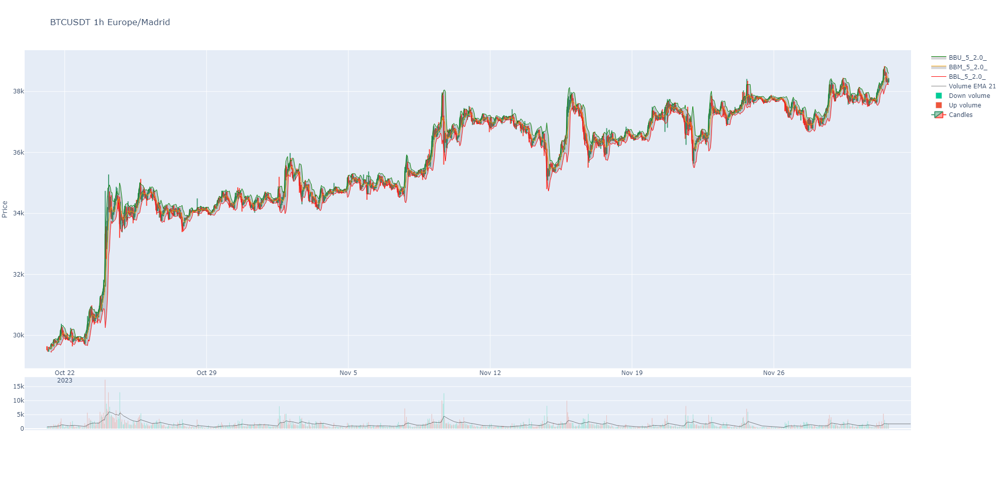

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [37]:
btcusdt.drop(inplace=True)
btcusdt.bbands()
btcusdt.plot()

In [38]:
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp,BBL_5_2.0_,BBM_5_2.0_,BBU_5_2.0_,BBB_5_2.0_,BBP_5_2.0_
BTCUSDT 1h Europe/Madrid,,,,,,,,,,,,,,,,,,,
2023-10-20 01:00:00+02:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-10-20 02:00:00+02:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-10-20 03:00:00+02:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-10-20 04:00:00+02:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-10-20 05:00:00+02:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-02 14:00:00+01:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-12-02 15:00:00+01:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2023-12-02 16:00:00+01:00,NaT,NaN,NaN,NaN,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Clean for Stochastic Oscillator

In [39]:
btcusdt = binpan.Symbol(symbol='BTCUSDT', tick_interval='1m', time_zone='Europe/Madrid')
btcusdt.df

2023-12-01	 17:33:19     INFO get_candles_by_time_stamps -> symbol=BTCUSDT tick_interval=1m start=2023-12-01 00:53:19 end=2023-12-01 17:32:58 limit=1000
2023-12-01	 17:33:20     INFO Pruned overtime_candle_ts 1 candles from API response for BTCUSDT 1m


,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp
BTCUSDT 1m Europe/Madrid,,,,,,,,,,,,,,
2023-12-01 00:54:00+01:00,2023-12-01 00:54:00+01:00,37708.86,37708.86,37708.85,37708.86,6.10724,2023-12-01 00:54:59.999000+01:00,2.302970e+05,252,5.22149,1.968964e+05,0,1701388440000,1701388499999
2023-12-01 00:55:00+01:00,2023-12-01 00:55:00+01:00,37708.85,37708.86,37708.85,37708.86,4.41992,2023-12-01 00:55:59.999000+01:00,1.666701e+05,265,1.75157,6.604971e+04,0,1701388500000,1701388559999
2023-12-01 00:56:00+01:00,2023-12-01 00:56:00+01:00,37708.85,37708.86,37708.85,37708.86,4.47888,2023-12-01 00:56:59.999000+01:00,1.688934e+05,221,0.46607,1.757497e+04,0,1701388560000,1701388619999
2023-12-01 00:57:00+01:00,2023-12-01 00:57:00+01:00,37708.86,37708.86,37705.45,37705.46,5.24001,2023-12-01 00:57:59.999000+01:00,1.975845e+05,357,1.74625,6.584477e+04,0,1701388620000,1701388679999
2023-12-01 00:58:00+01:00,2023-12-01 00:58:00+01:00,37705.45,37705.47,37705.45,37705.47,4.13830,2023-12-01 00:58:59.999000+01:00,1.560365e+05,235,3.64117,1.372920e+05,0,1701388680000,1701388739999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-01 17:28:00+01:00,2023-12-01 17:28:00+01:00,38734.82,38765.57,38729.32,38765.57,115.27493,2023-12-01 17:28:59.999000+01:00,4.466305e+06,3316,65.34237,2.531674e+06,0,1701448080000,1701448139999
2023-12-01 17:29:00+01:00,2023-12-01 17:29:00+01:00,38765.56,38793.55,38746.01,38793.54,81.41265,2023-12-01 17:29:59.999000+01:00,3.156159e+06,2868,46.54451,1.804512e+06,0,1701448140000,1701448199999
2023-12-01 17:30:00+01:00,2023-12-01 17:30:00+01:00,38793.55,38793.55,38691.10,38694.99,84.79123,2023-12-01 17:30:59.999000+01:00,3.284969e+06,3173,21.18255,8.206081e+05,0,1701448200000,1701448259999


In [40]:
btcusdt.stoch()

2023-12-01	 17:33:20     INFO New column: STOCHk_14_3_3
2023-12-01	 17:33:20     INFO New column: STOCHd_14_3_3


,STOCHk_14_3_3,STOCHd_14_3_3
BTCUSDT 1m Europe/Madrid,,
2023-12-01 01:07:00+01:00,NaN,NaN
2023-12-01 01:08:00+01:00,NaN,NaN
2023-12-01 01:09:00+01:00,1.451947,NaN
2023-12-01 01:10:00+01:00,1.392898,NaN
2023-12-01 01:11:00+01:00,7.797522,3.547456
...,...,...
2023-12-01 17:28:00+01:00,99.085903,97.656709
2023-12-01 17:29:00+01:00,99.186060,98.269205
2023-12-01 17:30:00+01:00,88.996525,95.756163


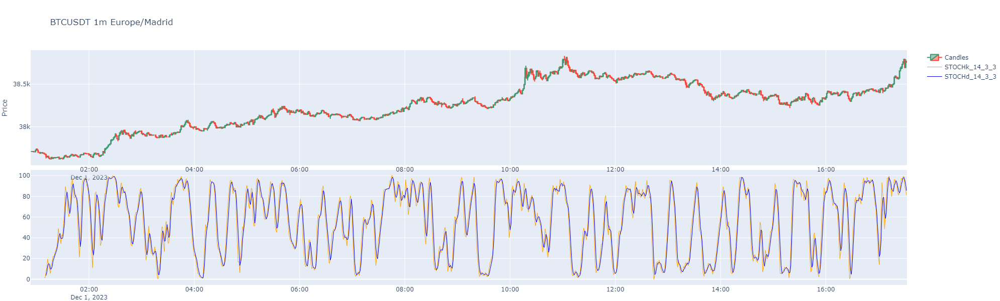

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [41]:
btcusdt.plot(volume=False, height=600, candles_ta_height_ratio=0.5)

# Simple indicator addition by insertion

In [42]:
btcusdt = binpan.Symbol(symbol='BTCUSDT', tick_interval='1m', time_zone='Europe/Madrid')
btcusdt.df

2023-12-01	 17:33:21     INFO get_candles_by_time_stamps -> symbol=BTCUSDT tick_interval=1m start=2023-12-01 00:53:21 end=2023-12-01 17:32:58 limit=1000
2023-12-01	 17:33:22     INFO Pruned overtime_candle_ts 1 candles from API response for BTCUSDT 1m


,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp
BTCUSDT 1m Europe/Madrid,,,,,,,,,,,,,,
2023-12-01 00:54:00+01:00,2023-12-01 00:54:00+01:00,37708.86,37708.86,37708.85,37708.86,6.10724,2023-12-01 00:54:59.999000+01:00,2.302970e+05,252,5.22149,1.968964e+05,0,1701388440000,1701388499999
2023-12-01 00:55:00+01:00,2023-12-01 00:55:00+01:00,37708.85,37708.86,37708.85,37708.86,4.41992,2023-12-01 00:55:59.999000+01:00,1.666701e+05,265,1.75157,6.604971e+04,0,1701388500000,1701388559999
2023-12-01 00:56:00+01:00,2023-12-01 00:56:00+01:00,37708.85,37708.86,37708.85,37708.86,4.47888,2023-12-01 00:56:59.999000+01:00,1.688934e+05,221,0.46607,1.757497e+04,0,1701388560000,1701388619999
2023-12-01 00:57:00+01:00,2023-12-01 00:57:00+01:00,37708.86,37708.86,37705.45,37705.46,5.24001,2023-12-01 00:57:59.999000+01:00,1.975845e+05,357,1.74625,6.584477e+04,0,1701388620000,1701388679999
2023-12-01 00:58:00+01:00,2023-12-01 00:58:00+01:00,37705.45,37705.47,37705.45,37705.47,4.13830,2023-12-01 00:58:59.999000+01:00,1.560365e+05,235,3.64117,1.372920e+05,0,1701388680000,1701388739999
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-01 17:28:00+01:00,2023-12-01 17:28:00+01:00,38734.82,38765.57,38729.32,38765.57,115.27493,2023-12-01 17:28:59.999000+01:00,4.466305e+06,3316,65.34237,2.531674e+06,0,1701448080000,1701448139999
2023-12-01 17:29:00+01:00,2023-12-01 17:29:00+01:00,38765.56,38793.55,38746.01,38793.54,81.41265,2023-12-01 17:29:59.999000+01:00,3.156159e+06,2868,46.54451,1.804512e+06,0,1701448140000,1701448199999
2023-12-01 17:30:00+01:00,2023-12-01 17:30:00+01:00,38793.55,38793.55,38691.10,38694.99,84.79123,2023-12-01 17:30:59.999000+01:00,3.284969e+06,3173,21.18255,8.206081e+05,0,1701448200000,1701448259999


In [43]:
volume_diff = btcusdt.df['Volume'].diff()
volume_diff

BTCUSDT 1m Europe/Madrid
2023-12-01 00:54:00+01:00         NaN
2023-12-01 00:55:00+01:00    -1.68732
2023-12-01 00:56:00+01:00     0.05896
2023-12-01 00:57:00+01:00     0.76113
2023-12-01 00:58:00+01:00    -1.10171
                               ...   
2023-12-01 17:28:00+01:00    25.63448
2023-12-01 17:29:00+01:00   -33.86228
2023-12-01 17:30:00+01:00     3.37858
2023-12-01 17:31:00+01:00    31.98428
2023-12-01 17:32:00+01:00   -47.35807
Name: Volume, Length: 999, dtype: float64

In [44]:
zero = volume_diff*0
zero

BTCUSDT 1m Europe/Madrid
2023-12-01 00:54:00+01:00    NaN
2023-12-01 00:55:00+01:00   -0.0
2023-12-01 00:56:00+01:00    0.0
2023-12-01 00:57:00+01:00    0.0
2023-12-01 00:58:00+01:00   -0.0
                            ... 
2023-12-01 17:28:00+01:00    0.0
2023-12-01 17:29:00+01:00   -0.0
2023-12-01 17:30:00+01:00    0.0
2023-12-01 17:31:00+01:00    0.0
2023-12-01 17:32:00+01:00   -0.0
Name: Volume, Length: 999, dtype: float64

In [45]:
btcusdt.insert_indicator(source_data=[volume_diff, zero], plotting_rows=[2,2], names=['Volume_diff', 'Zero'], colors=['blue', 'darkgrey'])
btcusdt.row_control

2023-12-01	 17:33:23     INFO New column: Volume_diff
2023-12-01	 17:33:23     INFO New column: Zero


{'Volume_diff': 2, 'Zero': 3}

In [46]:
btcusdt.set_plot_row('Zero', 2)
btcusdt.row_control

{'Volume_diff': 2, 'Zero': 2}

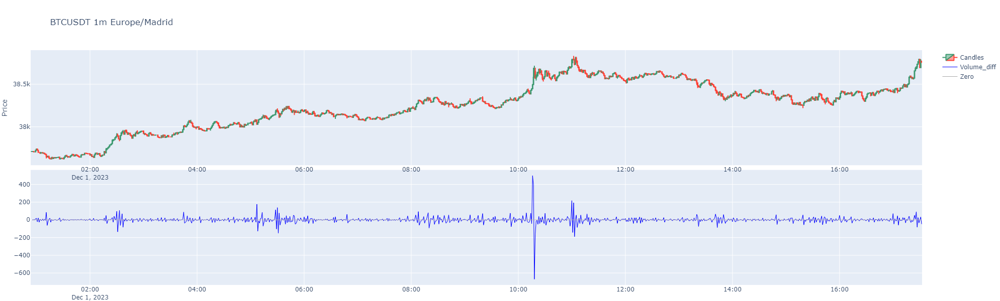

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [47]:
btcusdt.plot(volume=False, height=600, candles_ta_height_ratio=0.5)

## Check for 3 positive volume differences in a row.
This was just an experiment.

In [48]:
btcusdt.df

,Open time,Open,High,Low,Close,Volume,Close time,Quote volume,Trades,Taker buy base volume,Taker buy quote volume,Ignore,Open timestamp,Close timestamp,Volume_diff,Zero
BTCUSDT 1m Europe/Madrid,,,,,,,,,,,,,,,,
2023-12-01 00:54:00+01:00,2023-12-01 00:54:00+01:00,37708.86,37708.86,37708.85,37708.86,6.10724,2023-12-01 00:54:59.999000+01:00,2.302970e+05,252,5.22149,1.968964e+05,0,1701388440000,1701388499999,NaN,NaN
2023-12-01 00:55:00+01:00,2023-12-01 00:55:00+01:00,37708.85,37708.86,37708.85,37708.86,4.41992,2023-12-01 00:55:59.999000+01:00,1.666701e+05,265,1.75157,6.604971e+04,0,1701388500000,1701388559999,-1.68732,-0.0
2023-12-01 00:56:00+01:00,2023-12-01 00:56:00+01:00,37708.85,37708.86,37708.85,37708.86,4.47888,2023-12-01 00:56:59.999000+01:00,1.688934e+05,221,0.46607,1.757497e+04,0,1701388560000,1701388619999,0.05896,0.0
2023-12-01 00:57:00+01:00,2023-12-01 00:57:00+01:00,37708.86,37708.86,37705.45,37705.46,5.24001,2023-12-01 00:57:59.999000+01:00,1.975845e+05,357,1.74625,6.584477e+04,0,1701388620000,1701388679999,0.76113,0.0
2023-12-01 00:58:00+01:00,2023-12-01 00:58:00+01:00,37705.45,37705.47,37705.45,37705.47,4.13830,2023-12-01 00:58:59.999000+01:00,1.560365e+05,235,3.64117,1.372920e+05,0,1701388680000,1701388739999,-1.10171,-0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-01 17:28:00+01:00,2023-12-01 17:28:00+01:00,38734.82,38765.57,38729.32,38765.57,115.27493,2023-12-01 17:28:59.999000+01:00,4.466305e+06,3316,65.34237,2.531674e+06,0,1701448080000,1701448139999,25.63448,0.0
2023-12-01 17:29:00+01:00,2023-12-01 17:29:00+01:00,38765.56,38793.55,38746.01,38793.54,81.41265,2023-12-01 17:29:59.999000+01:00,3.156159e+06,2868,46.54451,1.804512e+06,0,1701448140000,1701448199999,-33.86228,-0.0
2023-12-01 17:30:00+01:00,2023-12-01 17:30:00+01:00,38793.55,38793.55,38691.10,38694.99,84.79123,2023-12-01 17:30:59.999000+01:00,3.284969e+06,3173,21.18255,8.206081e+05,0,1701448200000,1701448259999,3.37858,0.0


In [49]:
positive_col_row = btcusdt.df['Volume_diff'].rolling(window=3).agg(lambda x: (x > 0).sum())
positive_col_row[positive_col_row==3]

BTCUSDT 1m Europe/Madrid
2023-12-01 01:26:00+01:00    3.0
2023-12-01 02:13:00+01:00    3.0
2023-12-01 02:14:00+01:00    3.0
2023-12-01 02:25:00+01:00    3.0
2023-12-01 02:53:00+01:00    3.0
                            ... 
2023-12-01 16:36:00+01:00    3.0
2023-12-01 16:42:00+01:00    3.0
2023-12-01 16:51:00+01:00    3.0
2023-12-01 17:13:00+01:00    3.0
2023-12-01 17:26:00+01:00    3.0
Name: Volume_diff, Length: 50, dtype: float64

# Fractal

In [50]:
sym = binpan.Symbol(symbol='ltcusdt',
                        tick_interval='1h',
                        limit=200,
                        time_zone='Europe/Madrid')

2023-12-01	 17:33:24     INFO get_candles_by_time_stamps -> symbol=LTCUSDT tick_interval=1h start=2023-11-23 09:33:24 end=2023-12-01 16:59:58 limit=200
2023-12-01	 17:33:24  WARNING API response missing 800 klines for LTCUSDT 2023-11-23 09:33:24 to 2023-12-01 17:33:24 expected 1000 got 200
2023-12-01	 17:33:24     INFO Pruned overtime_candle_ts 1 candles from API response for LTCUSDT 1h


In [51]:
sym.fractal(period=5)

2023-12-01	 17:33:25     INFO New column: Fractal_W_5
2023-12-01	 17:33:25     INFO New column: Fractal_W_5_values


,Fractal_W_5,Fractal_W_5_values
LTCUSDT 1h Europe/Madrid,,
2023-11-23 10:00:00+01:00,0.0,NaN
2023-11-23 11:00:00+01:00,0.0,NaN
2023-11-23 12:00:00+01:00,0.0,NaN
2023-11-23 13:00:00+01:00,0.0,NaN
2023-11-23 14:00:00+01:00,0.0,NaN
...,...,...
2023-12-01 12:00:00+01:00,0.0,NaN
2023-12-01 13:00:00+01:00,0.0,NaN
2023-12-01 14:00:00+01:00,0.0,NaN


In [52]:
sym.color_control

{'Fractal_W_5': 'black', 'Fractal_W_5_values': 'black'}

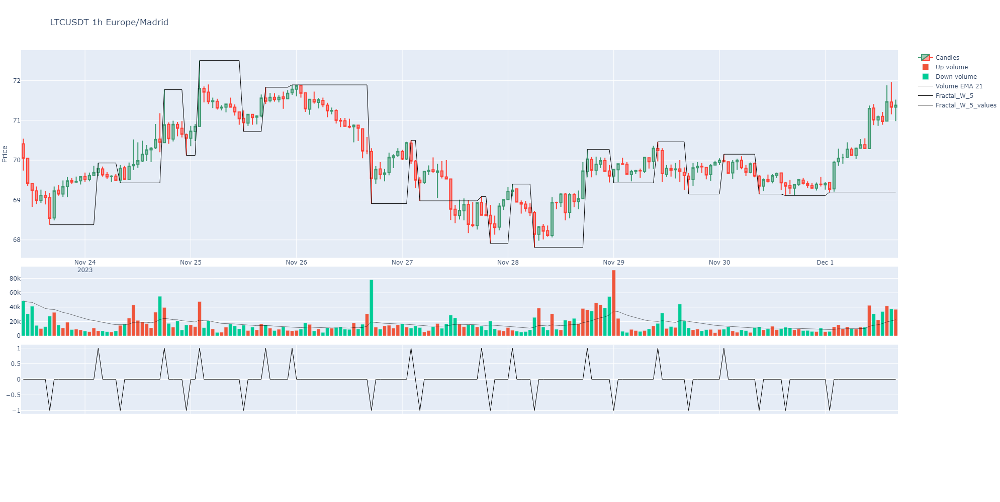

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [53]:
sym.plot(candles_ta_height_ratio=0.5)

# Alternating Fractal
This custom indicator shows the minimum period in finding a pure alternating fractal. It is some kind of volatility in price indicator, the most period needed, the most volatile price.

In [54]:
sym = binpan.Symbol(symbol='btcusdt',
                        tick_interval='1m',
                        limit=2000,
                        time_zone='Europe/Madrid')

2023-12-01	 17:33:25     INFO get_candles_by_time_stamps -> symbol=BTCUSDT tick_interval=1m start=2023-11-30 08:13:25 end=2023-12-01 17:32:58 limit=1000
2023-12-01	 17:33:26     INFO Pruned overtime_candle_ts 1 candles from API response for BTCUSDT 1m


In [55]:
fractal, maximums_mean, minimums_mean = sym.alternating_fractal(max_period=1000, overlap_plot=True, with_trend=True)
maximums_mean, minimums_mean

Searching for pure alternating fractal...


  0%|          | 0/998 [00:00<?, ?it/s]

2023-12-01	 17:33:44     INFO Increasing maxima and increasing minima. uptrend
2023-12-01	 17:33:44     INFO Max mean: 433.02999999999884 Min mean: 104.0
2023-12-01	 17:33:44     INFO New column: Fractal_W_193
2023-12-01	 17:33:44     INFO New column: Fractal_W_193_values


Pure alternating fractal found at period=193
Maximum_max_diff=1025.6299999999974
Minimum_max_diff=-159.5699999999997
Maximum_min_diff=104.0
Minimum_min_diff=104.0
Increasing maxima and increasing minima. uptrend


(433.02999999999884, 104.0)

In [56]:
fractal.dropna()

,Fractal_W_193,Fractal_W_193_values
BTCUSDT 1m Europe/Madrid,,
2023-11-30 14:45:00+01:00,1.0,37966.94
2023-11-30 15:04:00+01:00,-1.0,37500.00
2023-11-30 19:23:00+01:00,1.0,37807.37
2023-12-01 00:03:00+01:00,-1.0,37604.00
2023-12-01 11:02:00+01:00,1.0,38833.00


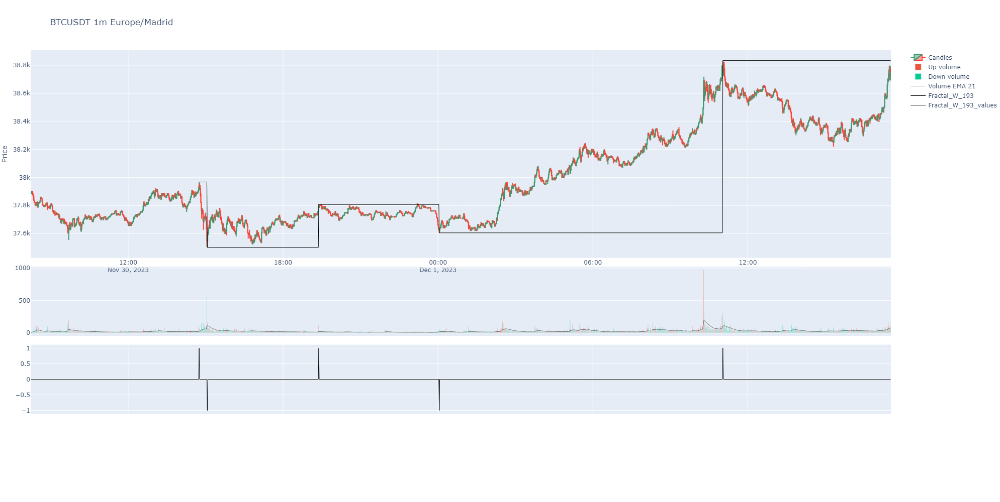

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [57]:
sym.plot(candles_ta_height_ratio=0.5)

# Market Profile Indicator

In [58]:
mp = sym.get_market_profile(bins=100)
mp

2023-12-01	 17:33:46     INFO Using klines data. For deeper info add trades data, example: my_symbol.get_agg_trades()
E:\PycharmProjects\binpan_studio\handlers\indicators.py:1084: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



,Taker buy base volume,Maker buy base volume
Price_Bin_BTCUSDT 1m Europe/Madrid_Klines,,
"(37533.342, 37547.295]",80.21099,81.73991
"(37547.295, 37559.98]",123.01689,145.08947
"(37559.98, 37572.665]",266.64824,439.73955
"(37572.665, 37585.35]",130.84663,118.38942
"(37585.35, 37598.035]",146.33697,150.66555
...,...,...
"(38739.679, 38752.364]",185.68251,139.89441
"(38752.364, 38765.049]",262.80824,177.37220
"(38765.049, 38777.733]",46.54451,34.86814


2023-12-01	 17:33:46     INFO Using klines data. For deeper info add trades data, example: my_symbol.get_agg_trades()
E:\PycharmProjects\binpan_studio\handlers\plotting.py:1384: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



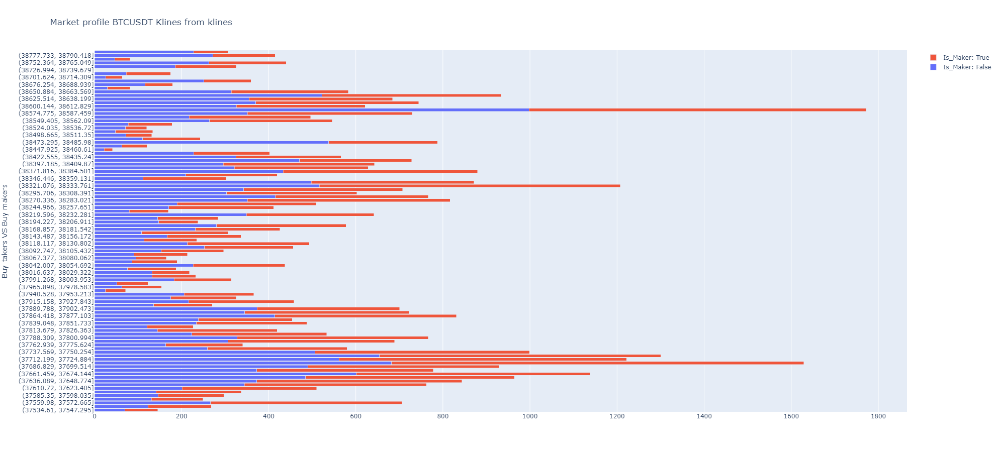

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [59]:
sym.plot_market_profile()

# Taker Maker ratio by price leves

In [60]:
sym.get_taker_maker_ratio_profile()

Price_Bin_BTCUSDT 1m Europe/Madrid_Klines
(37533.342, 37547.295]    0.495280
(37547.295, 37559.98]     0.458836
(37559.98, 37572.665]     0.377481
(37572.665, 37585.35]     0.524991
(37585.35, 37598.035]     0.492713
                            ...   
(38739.679, 38752.364]    0.570318
(38752.364, 38765.049]    0.597047
(38765.049, 38777.733]    0.571711
(38777.733, 38790.418]    0.655153
(38790.418, 38803.103]    0.742425
Length: 100, dtype: float64

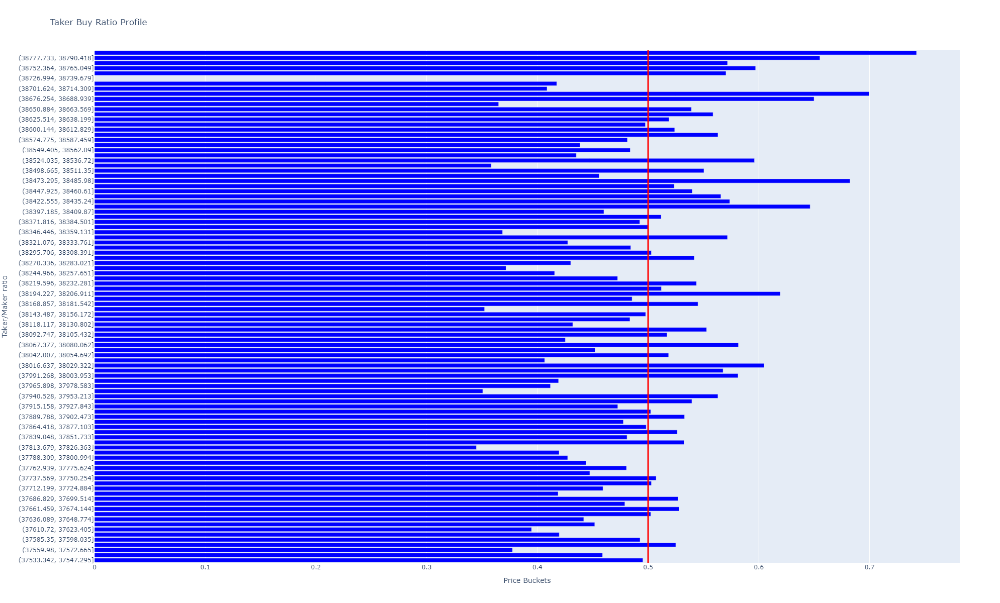

'E:\\PycharmProjects\\binpan_studio\\last_plot.png'

In [61]:
sym.plot_taker_maker_ratio_profile()